In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import pathlib

import torch
import torchaudio

from tqintel import DATA_DIR
from tqintel.utils import play_audio, print_stats
from tqintel.plots import plot_spectrogram, plot_waveform
from tqintel.transforms import get_melspectrogram, get_spectrogram
from tqintel.effects import add_drops, add_noise

/Users/christophersantiago/opt/miniconda3/envs/tqintel/lib/python3.9/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [8]:
files = list(DATA_DIR.joinpath('wavs').glob('**/*.wav'))
waveform, sample_rate = torchaudio.load(files[0])

In [9]:
print_stats(waveform, sample_rate)

Sample Rate: 16000
Shape: (1, 1066646)
Dtype: torch.float32
 - Max:      0.364
 - Min:     -0.475
 - Mean:     0.000
 - Std Dev:  0.050

tensor([[ 3.9876e-05,  1.3715e-04,  3.0458e-04,  ..., -5.5850e-05,
         -7.8142e-05, -6.3121e-05]])



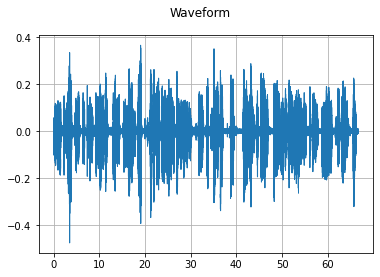

In [5]:
plot_waveform(waveform, sample_rate)

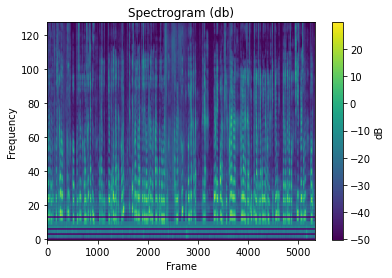

In [44]:
mel = torchaudio.transforms.MelSpectrogram(n_mels=128)
spec = mel(waveform)[0]
plot_spectrogram(spec)

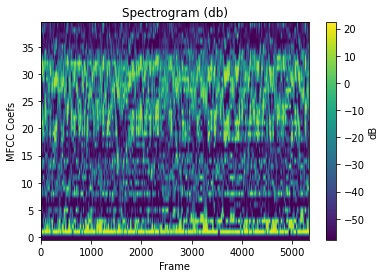

In [45]:
cfcc = torchaudio.transforms.MFCC()
spec = cfcc(waveform)[0]
plot_spectrogram(spec, ylabel='MFCC Coefs')

In [6]:
play_audio(waveform, sample_rate)

----------

In [47]:
noisy = add_noise(waveform, .05, mu=.0, sigma=.05)

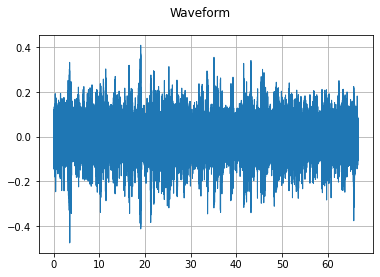

In [48]:
plot_waveform(noisy, sample_rate)

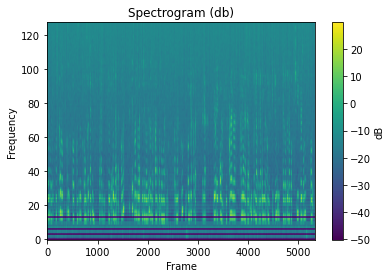

In [49]:
mel = torchaudio.transforms.MelSpectrogram(n_mels=128)
spec = mel(noisy)[0]
plot_spectrogram(spec)

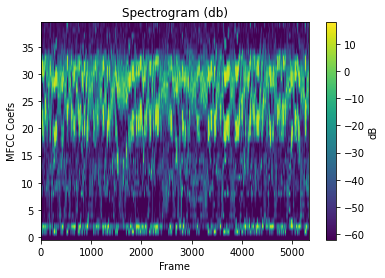

In [50]:
cfcc = torchaudio.transforms.MFCC()
spec = cfcc(noisy)[0]
plot_spectrogram(spec, ylabel='MFCC Coefs')

In [32]:
play_audio(noisy, sample_rate)

----------

In [51]:
drops = add_drops(waveform, .15)

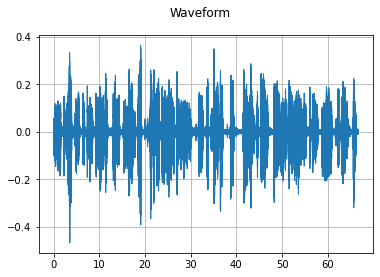

In [52]:
plot_waveform(drops, sample_rate)

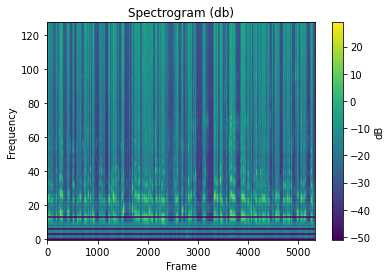

In [53]:
mel = torchaudio.transforms.MelSpectrogram(n_mels=128)
spec = mel(drops)[0]
plot_spectrogram(spec)

In [36]:
play_audio(drops, sample_rate)

----------

## 6 min+ audio file

In [57]:
fn = '../data/wavs/53831_35465_1574467200.wav'
waveform, sample_rate = torchaudio.load(fn)
print_stats(waveform, sample_rate)

Sample Rate: 16000
Shape: (1, 6030501)
Dtype: torch.float32
 - Max:      0.625
 - Min:     -0.614
 - Mean:     0.000
 - Std Dev:  0.045

tensor([[0., 0., 0.,  ..., 0., 0., 0.]])



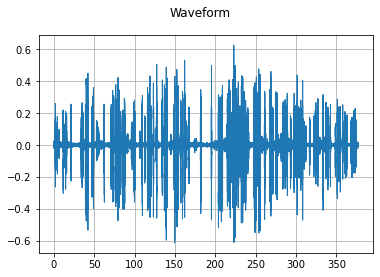

In [58]:
plot_waveform(waveform, sample_rate)

In [59]:
play_audio(waveform, sample_rate)

-------

In [53]:
fn = '../data/splits/1173_GM1001_1326493712_split_1.wav'
waveform, sample_rate = torchaudio.load(fn)
print_stats(waveform, sample_rate)

Sample Rate: 16000
Shape: (1, 320000)
Dtype: torch.float32
 - Max:      0.571
 - Min:     -0.651
 - Mean:    -0.000
 - Std Dev:  0.067

tensor([[-0.0009, -0.0008, -0.0007,  ...,  0.0009, -0.0016, -0.0024]])



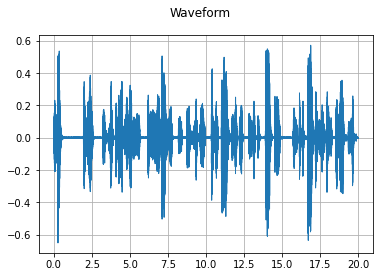

In [54]:
plot_waveform(waveform, sample_rate)

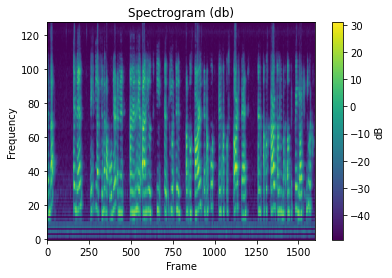

In [56]:
mel = torchaudio.transforms.MelSpectrogram(n_mels=128)
spec = mel(waveform)[0]
plot_spectrogram(spec)

In [57]:
play_audio(waveform, sample_rate)

In [58]:
noisy = add_noise(waveform, .20, mu=.0, sigma=.07)

In [59]:
play_audio(noisy, sample_rate)

In [60]:
drops = add_drops(waveform, .15)

In [61]:
play_audio(drops, sample_rate)

## Notes

- I thought these were all the same script?  This file sounds like a story about Lion King, not reading a passage from Alice in Wonderland.
    - How will this affect modeling??
- Reading times range from 1min to 6min

In [63]:
spec.shape

torch.Size([128, 1601])

In [70]:
torch.load('../data/specgrams/1173_GM1001_1326493712_split_0_spec.pt')[0].flatten().shape

torch.Size([204928])

In [71]:
torch.load('../data/specgrams/1173_GM1001_1326493712_split_0_spec.pt').flatten().shape

torch.Size([204928])

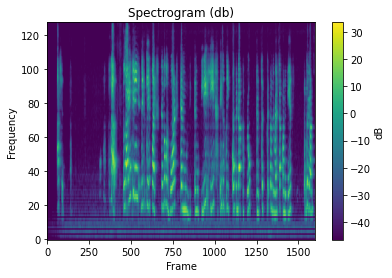

In [73]:
plot_spectrogram(torch.load('../data/specgrams/1173_GM1001_1326493712_split_0_spec.pt')[0])

In [74]:
torch.load('../data/specgrams/1173_GM1001_1326493712_split_0_spec.pt').flatten().numpy()

array([0.0000000e+00, 0.0000000e+00, 0.0000000e+00, ..., 3.4730369e-06,
       2.8706586e-06, 5.2232399e-06], dtype=float32)